In [1]:
# libraries
import urllib.request, json 
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from sodapy import Socrata

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
results = pd.read_json( r'https://controllerdata.lacity.org/resource/bawf-ixme.json?$limit=15000' )

# We'll need to convert to pandas DataFrame
public = pd.DataFrame.from_records(results)

public.sample(5)

,objectid,ain,taxratearea,situshouseno,agencyclassno,usecode,recdate,taxratearea_city,usecode_2,usedescription,...,effectiveyear1,units1,bedrooms1,bathrooms1,sqft,propertylocation,situsunit,situsdirection,situsfraction,secondagencyname
12957,12988,7440020912,14,0,236860.0,800V,19860101,LOS ANGELES,80.0,Miscellaneous,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12064,12063,7413025950,14,0,236970.0,010C,19750101,LOS ANGELES,1.0,Single,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6951,6939,5094006901,6657,692,374380.0,2700,20050404,LOS ANGELES,27.0,Parking Lots (Commercial Use Properties),...,NaN,NaN,NaN,NaN,NaN,692 S MARIPOSA AVE LOS ANGELES CA 90005-2604,NaN,S,NaN,NaN
3114,3117,2681010911,16,11254,374380.0,8832,19720000,LOS ANGELES,88.0,Government Parcel,...,NaN,NaN,NaN,NaN,NaN,11254 GOTHIC AVE LOS ANGELES CA 91344-3709,NaN,NaN,NaN,NaN
6889,6877,5080023903,6657,980,374380.0,100,19760419,LOS ANGELES,1.0,Single,...,NaN,NaN,NaN,NaN,NaN,980 S HOBART BLVD LOS ANGELES CA 90006-1220,NaN,S,NaN,NaN


In [3]:
public.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13948 entries, 0 to 13947
Data columns (total 50 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   objectid                   13948 non-null  int64  
 1   ain                        13948 non-null  int64  
 2   taxratearea                13948 non-null  int64  
 3   situshouseno               13948 non-null  int64  
 4   agencyclassno              13608 non-null  float64
 5   usecode                    13709 non-null  object 
 6   recdate                    13948 non-null  int64  
 7   taxratearea_city           13948 non-null  object 
 8   usecode_2                  13707 non-null  float64
 9   usedescription             13698 non-null  object 
 10  usetype                    13698 non-null  object 
 11  legaldesc                  13948 non-null  object 
 12  councildistrict            13948 non-null  int64  
 13  countydistrict             13948 non-null  int

In [12]:
print(public.columns)

Index(['objectid', 'ain', 'taxratearea', 'situshouseno', 'agencyclassno',
       'usecode', 'recdate', 'taxratearea_city', 'usecode_2', 'usedescription',
       'usetype', 'legaldesc', 'councildistrict', 'countydistrict',
       'senatedistrict', 'assemblydistrict', 'congressdistrict',
       'neighborhoodcouncilname', 'agencyname', 'assessorid',
       'parcelboundarydescription', 'entityowner', 'name', 'class',
       'area_sq_footage', 'federal', 'state', 'county', 'city', 'metro',
       'lausd', 'shape_length', 'shape_area', 'centroid_x', 'centroid_y',
       'situsstreet', 'situscity', 'situszip', 'designtype1', 'yearbuilt1',
       'effectiveyear1', 'units1', 'bedrooms1', 'bathrooms1', 'sqft',
       'propertylocation', 'situsunit', 'situsdirection', 'situsfraction',
       'secondagencyname', 'geometry'],
      dtype='object')


In [4]:
# looks like we have 33091 vacant parcels in LA incorporated, we will need to convert our df to gdf for vacant parcels
# since data is in lat/lon's we will assign the crs to WGS84 (epsg:4326)
public = gpd.GeoDataFrame(public, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(public.centroid_x, public.centroid_y))

In [5]:
public.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

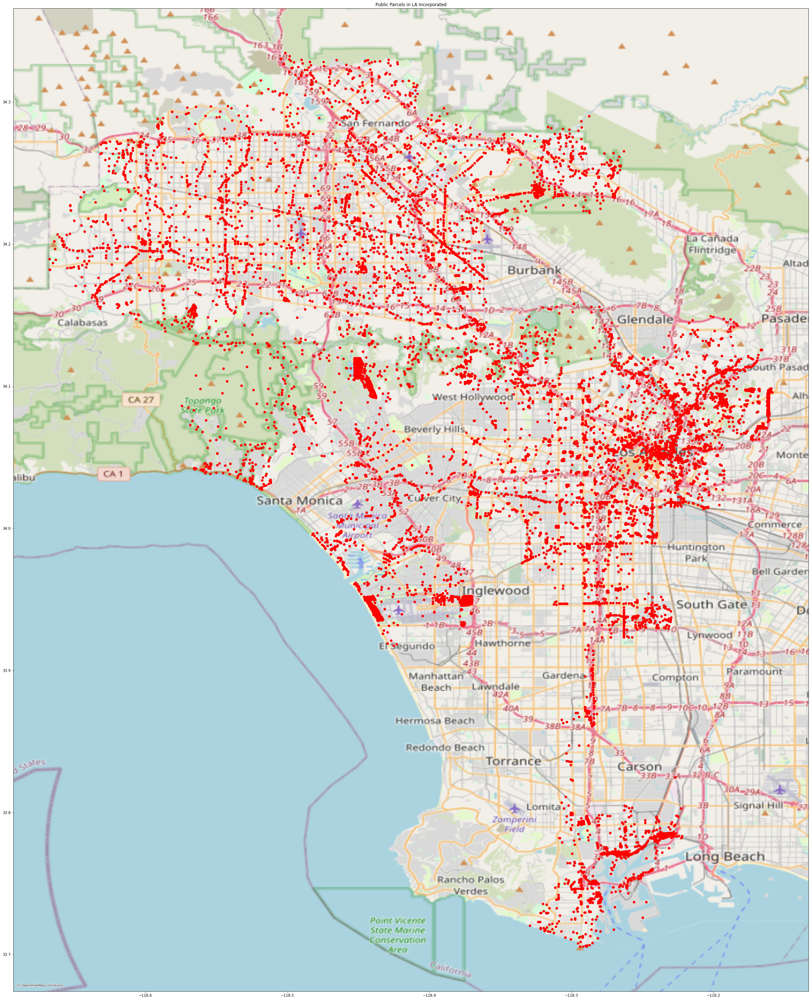

In [6]:
# to map vacant parcels
fig, ax = plt.subplots(figsize=(50,50))

public.plot(ax=ax,
                      color='red')

# keeping the axis on for now and will turn off later
ax.axis('on')

ax.set_title('Public Parcels in LA Incorporated')

# we are interested in seeing LA county map features and will use this basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs=public.crs)

In [8]:
public_web = public.to_crs('EPSG:3857')

In [16]:
public_web = public_web.fillna('N/A')

In [18]:
public_web.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 13948 entries, 0 to 13947
Data columns (total 51 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   objectid                   13948 non-null  int64   
 1   ain                        13948 non-null  int64   
 2   taxratearea                13948 non-null  int64   
 3   situshouseno               13948 non-null  int64   
 4   agencyclassno              13948 non-null  object  
 5   usecode                    13948 non-null  object  
 6   recdate                    13948 non-null  int64   
 7   taxratearea_city           13948 non-null  object  
 8   usecode_2                  13948 non-null  object  
 9   usedescription             13948 non-null  object  
 10  usetype                    13948 non-null  object  
 11  legaldesc                  13948 non-null  object  
 12  councildistrict            13948 non-null  int64   
 13  countydistrict         

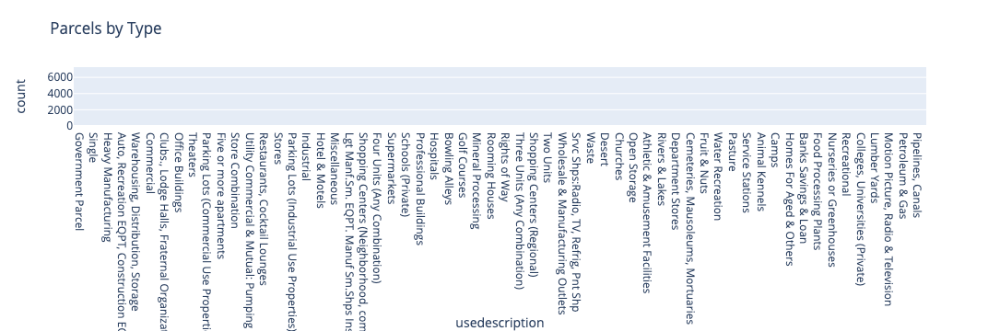

In [9]:
# for interactive plots
import plotly.express as px

# a simple bar chart, putting date on the x-axis
fig = px.bar(public,
       x='usedescription',
       title='Parcels by Type'
      )

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

# show the figure
fig.show()

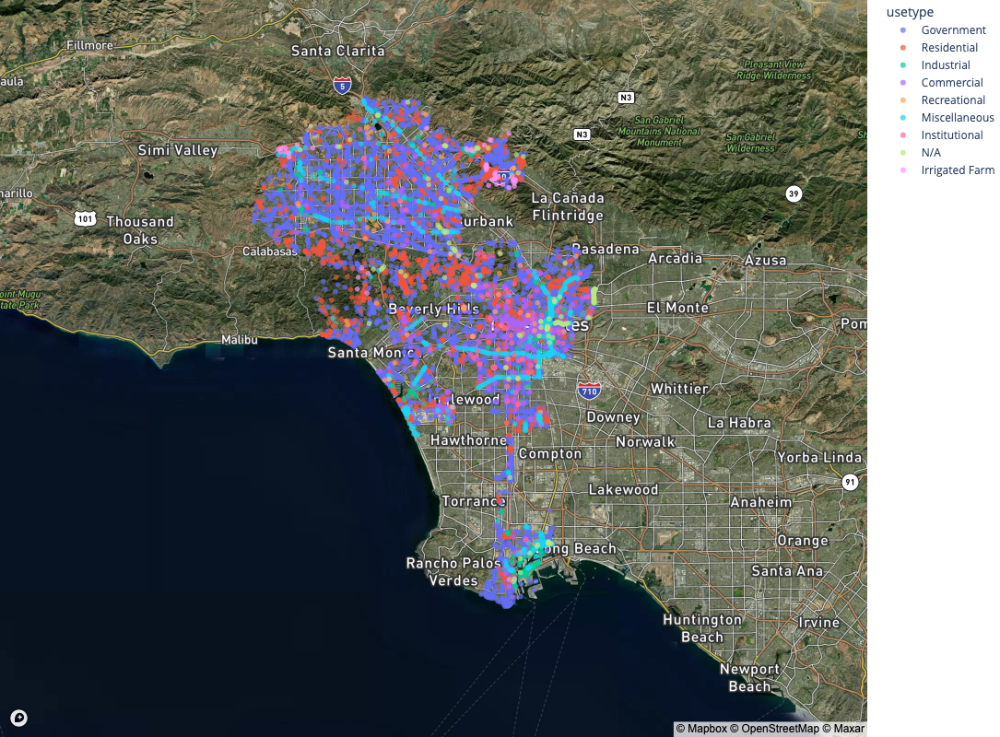

In [27]:
# set the mapbox access token
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

fig = px.scatter_mapbox(public_web,
                        lat="centroid_y",
                        lon="centroid_x",
                        hover_name="ain",
                        opacity=.7,
                        size_max=10,
                     zoom=9, 
                     color='usetype',
                     hover_data=['ain', 'taxratearea', 'agencyclassno', 'recdate', 'taxratearea_city', 'usedescription',
       'usetype', 'councildistrict', 'countydistrict',
       'senatedistrict', 'assemblydistrict', 'congressdistrict',
       'neighborhoodcouncilname', 'agencyname', 'entityowner',
       'area_sq_footage'],
                           center = {"lat": 34, "lon": -118.4},
                     width=1000,
                     height=800)

fig.update_layout(mapbox_style="satellite-streets")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

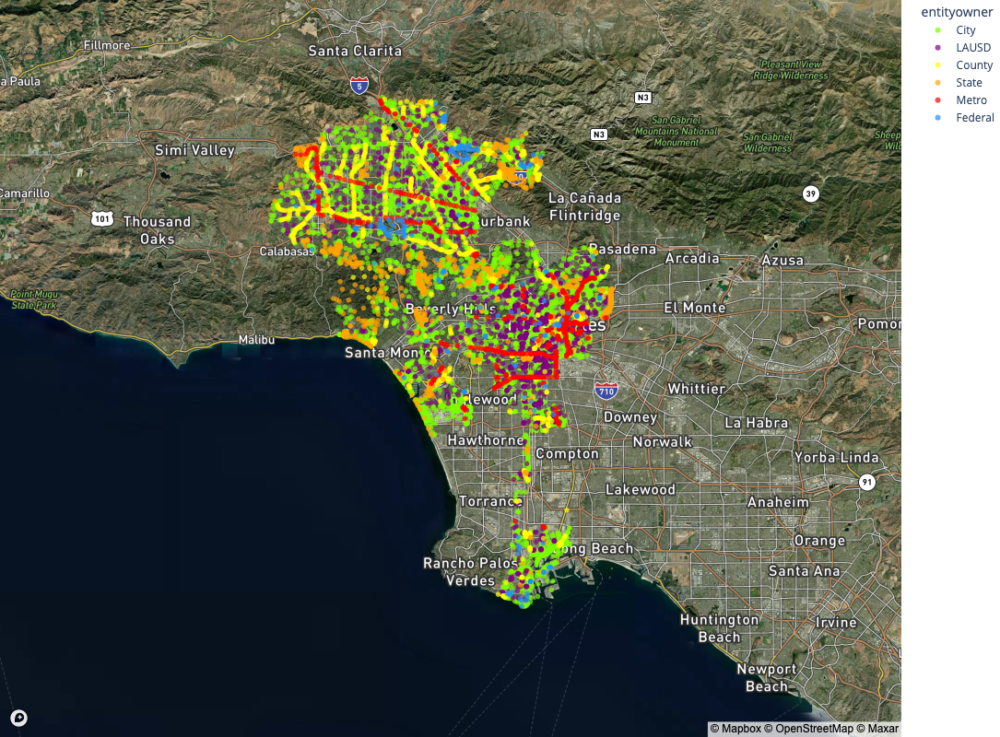

In [50]:
# set the mapbox access token
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

fig = px.scatter_mapbox(public_web,
                        lat="centroid_y",
                        lon="centroid_x",
                        hover_name="ain",
                        opacity=.7,
                        size_max=10,
                        color_discrete_sequence=['lawngreen', 'purple', 'yellow', 'orange', 'red', 'dodgerblue'],
                                                 zoom=9, 
                     color='entityowner',
                     hover_data=['ain', 'taxratearea', 'agencyclassno', 'recdate', 'taxratearea_city', 'usedescription',
       'usetype', 'councildistrict', 'countydistrict',
       'senatedistrict', 'assemblydistrict', 'congressdistrict',
       'neighborhoodcouncilname', 'agencyname', 'entityowner',
       'area_sq_footage'],
                           center = {"lat": 34, "lon": -118.4},
                     width=1000,
                     height=800)

fig.update_layout(mapbox_style="satellite-streets")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [29]:
median = public_web.area_sq_footage.describe()
public_web.area_sq_footage.describe()

count    1.394800e+04
mean     1.868556e+05
std      1.316610e+06
min      0.000000e+00
25%      5.256750e+03
50%      9.978000e+03
75%      5.523575e+04
max      7.679363e+07
Name: area_sq_footage, dtype: float64

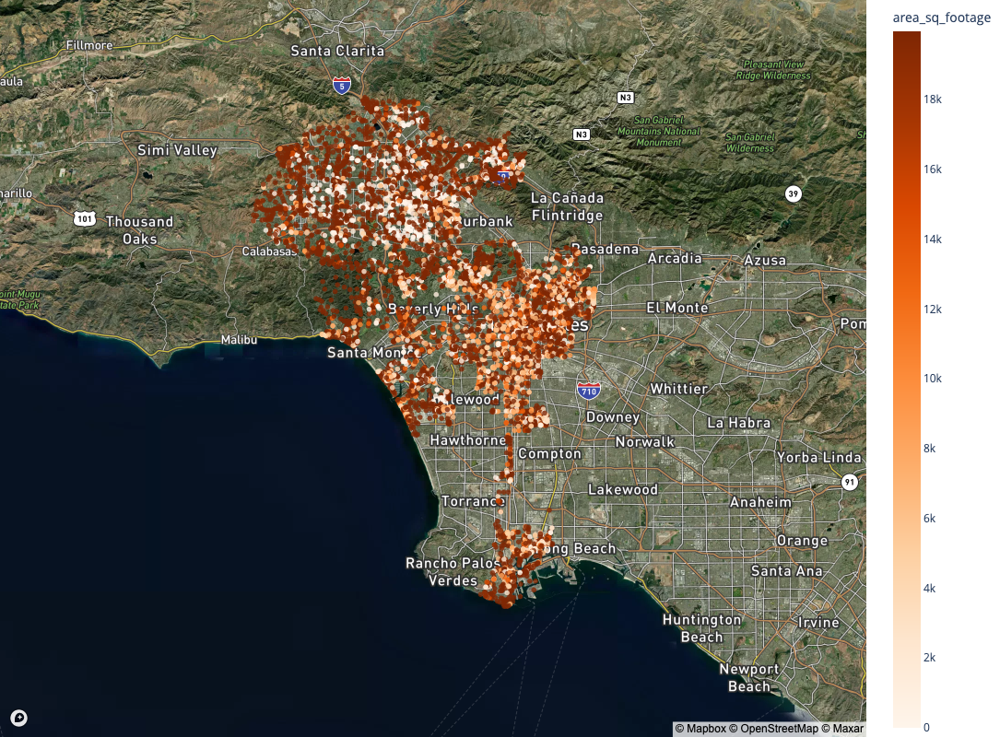

In [51]:
fig = px.scatter_mapbox(public_web, 
                     lat="centroid_y",
                        lon="centroid_x",
                     zoom=9, 
                     color='area_sq_footage',
                     color_continuous_scale='oranges',
                           color_continuous_midpoint = 9.978000e+03, # put the median as the midpoint
                     range_color =(0,9.978000e+03*2),
                     hover_data=['usetype'],
                     center = {"lat": 34, "lon": -118.4},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'percent_lag':'Vacant Parcel Percentages (Spatial Lag)',
                             'percent':'Vacant Parcel Percentages',
                     })
fig.update_layout(mapbox_style="satellite-streets")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()